## Title : Melihat Objective Problem Dari Dataset MNC

## Introduction

Nama peneliti : <b>Suma Bimantoro Andru</b>,<br> disini peneliti akan mencoba menganalisa terhadap dataset untuk melihat
permasalahan, `peneliti akan mencoba memberi insight,memberikan solusi dan kesimpulan dengan kemampuan peneliti sebagai data scientist dan Analyst`

## External Link

link(tidak bisa tampil di tablue dikarenakan dataset 1 giga)

# Working Area

# 1. Data Loading

In [1]:
# Import Libraries

import pandas as pd
import numpy as np

from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.compose import ColumnTransformer
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import MinMaxScaler, StandardScaler,OrdinalEncoder
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn import preprocessing
import plotly.express as px
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import Input
from tensorflow.keras import Model 
import tensorflow as tf
from tensorflow import keras
import pickle
import requests
import json
import requests
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV,cross_val_score
#stemming class from nltk
from nltk.stem.porter import PorterStemmer
#count vectorizor
from sklearn.feature_extraction.text import CountVectorizer
#cosine similarties to calculate the similarty measure between movies
from sklearn.metrics.pairwise import cosine_similarity

In [2]:
# Load Dataset

data = pd.read_csv('final data.csv')

In [3]:
# Tampilkan head
data.head(3)

,Unnamed: 0,viewers_id,content_id,hit_timestamp,user_type,category_id,tagging,creator_id,category_name,viewers_birthdate,viewers_gender,viewers_region
0,0,UN-RY8dNmQ,OC0RuX,2022-07-30,Anonymus User,23.0,"[{""tag_id"": ""l33saH"", ""tag_name"": ""nathalie-ho...",99jY83,Hiburan,NaN,NaN,NaN
1,1,UN-RY8dNmQ,OC0RuX,2022-07-30,Anonymus User,23.0,"[{""tag_id"": ""l33saH"", ""tag_name"": ""nathalie-ho...",99jY83,Hiburan,NaN,NaN,NaN
2,2,UN-b1g5Cc6,EsWkCd,2022-07-31,Anonymus User,23.0,"[{""tag_id"": ""Tw9Th4"", ""tag_name"": ""deddy-corbu...",99jY83,Hiburan,NaN,NaN,NaN


In [4]:
#tampilkan Tail
data.tail(6)

,Unnamed: 0,viewers_id,content_id,hit_timestamp,user_type,category_id,tagging,creator_id,category_name,viewers_birthdate,viewers_gender,viewers_region
958541,958541,UN-eRISZYj,1BZ98E,2022-08-29,Anonymus User,13.0,NaN,39jZ02,Humor,NaN,NaN,NaN
958542,958542,KTq08K,1BZ98E,2022-08-29,Register User,13.0,NaN,39jZ02,Humor,1987-11-05,Male,Jakarta
958543,958543,UN-eRISZYj,1BZ98E,2022-08-29,Anonymus User,13.0,NaN,39jZ02,Humor,NaN,NaN,NaN
958544,958544,KTq08K,1BZ98E,2022-08-29,Register User,13.0,NaN,39jZ02,Humor,1987-11-05,Male,Jakarta
958545,958545,UN-DHiHLsN,bDrGRd,2022-08-12,Anonymus User,13.0,"[{""tag_id"": ""D5mK4C"", ""tag_name"": ""dunia-polit...",99jY83,Humor,NaN,NaN,NaN
958546,958546,UN-DHiHLsN,bDrGRd,2022-08-12,Anonymus User,13.0,"[{""tag_id"": ""D5mK4C"", ""tag_name"": ""dunia-polit...",99jY83,Humor,NaN,NaN,NaN


In [5]:
#tampilkan informasi untuk melihat field
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 958547 entries, 0 to 958546
Data columns (total 12 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         958547 non-null  int64  
 1   viewers_id         958547 non-null  object 
 2   content_id         958547 non-null  object 
 3   hit_timestamp      958547 non-null  object 
 4   user_type          958547 non-null  object 
 5   category_id        958547 non-null  float64
 6   tagging            920275 non-null  object 
 7   creator_id         958547 non-null  object 
 8   category_name      958547 non-null  object 
 9   viewers_birthdate  4115 non-null    object 
 10  viewers_gender     4115 non-null    object 
 11  viewers_region     3988 non-null    object 
dtypes: float64(1), int64(1), object(10)
memory usage: 87.8+ MB


`Di dataset ini ada 12 columns, 958547 row, dan memilik 2 column bertipe numerik int dan float`

# 2 - Exploratory Data Analysis (EDA)

### Disini peneliti akan mencoba mengerti di setiap featured / column yang digunakan dataset ini

In [6]:
#check dataset
data.describe()

,Unnamed: 0,category_id
count,958547.000000,958547.000000
mean,479273.000000,29.518336
std,276708.828576,4.600161
min,0.000000,13.000000
25%,239636.500000,26.000000
50%,479273.000000,30.000000
75%,718909.500000,34.000000
max,958546.000000,36.000000


`Terlihat disini untuk column Unnamed sebanyak jumlah index banyaknnya ROW yang artinnya Column Unnamed sama seperti penomoran jumlah row`, untuk column `category_id , angka paling kecilnnya di angka 13 dan max 36, dan nilai median ada di angka 30, yang artinnya dimana paling banyak di category_id 30`, tapi peneliti akan mencari lebih jauh lagi untuk mengerti di EDA ini.

## Unnamed: 0

In [7]:
#Melihat uniqe data
data['Unnamed: 0'].unique()

array([     0,      1,      2, ..., 958544, 958545, 958546], dtype=int64)

In [8]:
#Melihat jumlah uniqe data
data['Unnamed: 0'].nunique()

958547

`jumlah index dan jumlah colum Unnamed terlihat sama, peneliti menyimpulkan column ini hanya sebagai penomoran saja`

## viewers_id

In [9]:
#Melihat uniq data
data['viewers_id'].unique()

array(['UN-RY8dNmQ', 'UN-b1g5Cc6', 'UN-kNqX0xJ', ..., 'UN-HreegbD',
       'UN-HRbhYvh', 'UN-DHiHLsN'], dtype=object)

In [10]:
#Melihat jumlah uniqe data
data['viewers_id'].nunique()

54632

Jumlah Viewers ada di `54632 dari 958547 banyaknnya row`

In [11]:
#melihat jumlah dan persen terhadap column viewers_id
(data['viewers_id'].nunique()/data['Unnamed: 0'].nunique())*100

5.69945970307142

`dari data disini peneliti menyimpulkan hanya 54632 penonton dimana 5.6% dari dataset yang dipunya MNC`

## content_id

In [12]:
#Melihat uniq data
data['content_id'].unique()

array(['OC0RuX', 'EsWkCd', 'WMKZwi', ..., 'Mr7l1C', '1BZ98E', 'bDrGRd'],
      dtype=object)

In [13]:
#Melihat jumlah uniqe data
data['content_id'].nunique()

24097

Terdapat 24097 content, `disini peneliti menyimpulkan dari data ini, bahwa MNC mempunyai 24097 content `

## hit_timestamp 

In [14]:
#Melihat uniq data
data['hit_timestamp'].unique()

array(['2022-07-30', '2022-07-31', '2022-08-13', '2022-09-15',
       '2022-08-14', '2022-11-13', '2022-09-08', '2022-09-07',
       '2022-11-12', '2022-09-14', '2022-08-29', '2022-08-19',
       '2022-08-15', '2022-09-01', '2022-08-12', '2022-11-11',
       '2022-08-31', '2022-08-16', '2022-08-18', '2022-08-17',
       '2022-08-28'], dtype=object)

In [15]:
#Melihat jumlah uniqe data
data['hit_timestamp'].nunique()

21

In [16]:
#menampilkan column
data[['viewers_id','content_id' ,'hit_timestamp']]

,viewers_id,content_id,hit_timestamp
0,UN-RY8dNmQ,OC0RuX,2022-07-30
1,UN-RY8dNmQ,OC0RuX,2022-07-30
2,UN-b1g5Cc6,EsWkCd,2022-07-31
3,UN-b1g5Cc6,EsWkCd,2022-07-31
4,UN-kNqX0xJ,WMKZwi,2022-07-31
...,...,...,...
958542,KTq08K,1BZ98E,2022-08-29
958543,UN-eRISZYj,1BZ98E,2022-08-29
958544,KTq08K,1BZ98E,2022-08-29
958545,UN-DHiHLsN,bDrGRd,2022-08-12


untuk `column hit_timestamp adalah penandaan tanggal dan seberapa sering di tanggal itu user dan conten tercaptured`

## user_type

In [17]:
#Melihat uniq data
data['user_type'].unique()

array(['Anonymus User', 'Register User'], dtype=object)

In [18]:
#Melihat jumlah uniqe data
data['user_type'].nunique()

2

(array([0, 1]), [Text(0, 0, 'Anonymus User'), Text(1, 0, 'Register User')])

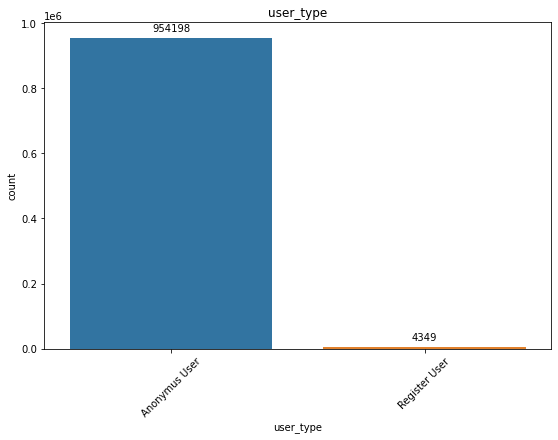

In [19]:
#membuat plot untuk cek user_type
plt.figure(figsize=(20, 6))
plt.subplot(1, 2, 1)
user_type = sns.countplot(x='user_type', data=data, order=data.user_type.value_counts().index)
for p in user_type.patches:
    user_type.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()), ha='center', va='center', xytext=(0, 10), textcoords='offset points')
plt.title('user_type')
plt.xlabel('user_type')
plt.ylabel('count')
plt.xticks(rotation=45)

Di Column ini ada 2, Anonymous User dan register user, `personal judgment peneliti adalah, karena MNC adalah perusahaan yang bisnis prossesnnya adalah siaran gratis dan mendapatkan uang dari iklan, artinnya user tidak perlu register untuk menonton content yang diberikan mnc, maka dari itu adannya Anonymus User`

## category_id & category_name

In [20]:
#Melihat uniq data
data['category_id'].unique()

array([23., 33., 30., 22., 34., 24., 35., 28., 26., 21., 29., 27., 36.,
       31., 32., 25., 20., 13.])

In [21]:
#Melihat uniq data
data['category_name'].unique()

array(['Hiburan', 'Wisata dan Kuliner', 'Olahraga', 'Gaya Hidup',
       'Politik & Peristiwa', 'Kebijakan Publik', 'Teknologi',
       'Keuangan dan Bisnis', 'Luxury', 'Ekonomi', 'Musik dan Film',
       'Kesehatan', 'Games', 'Otomotif', 'Gawai', 'Kecantikan', 'Budaya',
       'Humor'], dtype=object)

In [22]:
#Melihat jumlah uniqe data
data['category_id'].nunique()

18

In [23]:
#Melihat jumlah uniqe data
data['category_name'].nunique()

18

`Terlihat sama jumlah category_id dan category_name, disini peneliti menyimpulkan bahwa category id dan category name adalah satu kesatuan`

In [24]:
data[['user_type','category_id','category_name']]

,user_type,category_id,category_name
0,Anonymus User,23.0,Hiburan
1,Anonymus User,23.0,Hiburan
2,Anonymus User,23.0,Hiburan
3,Anonymus User,23.0,Hiburan
4,Anonymus User,23.0,Hiburan
...,...,...,...
958542,Register User,13.0,Humor
958543,Anonymus User,13.0,Humor
958544,Register User,13.0,Humor
958545,Anonymus User,13.0,Humor


In [25]:
Top10Category=data.groupby('category_name')['user_type'].agg(['count']).reset_index().sort_values(by='count',ascending=False).head(10)
Top10Category

,category_name,count
13,Olahraga,128653
15,Politik & Peristiwa,119309
16,Teknologi,97596
4,Gaya Hidup,95165
12,Musik dan Film,79260
17,Wisata dan Kuliner,62140
14,Otomotif,60700
2,Games,57155
7,Kebijakan Publik,52588
10,Keuangan dan Bisnis,44076


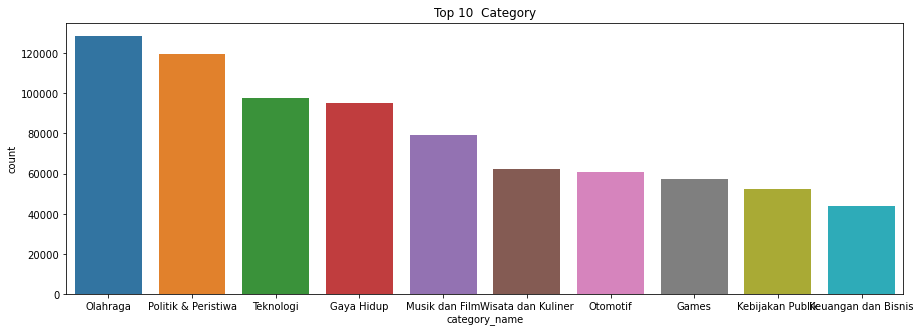

In [26]:
plt.figure(figsize=(15,5))
graph=sns.barplot(x='category_name',y='count',data=Top10Category)
graph.set_title('Top 10  Category')
plt.show()

`Terlihat dari data dan visual peringka 1 ada di categori conten olahraga`

## tagging

In [27]:
#Melihat uniq data
data['tagging'][0]

'[{"tag_id": "l33saH", "tag_name": "nathalie-holscher", "tag_slug": "nathalie-holscher", "status": 1, "created": {"$date": "2021-11-22T02:32:04.404Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "n3X0Hm", "tag_name": "sidang-cerai-nathalie-holscher", "tag_slug": "sidang-cerai-nathalie-holscher", "status": 1, "created": {"$date": "2022-07-15T08:40:23.444Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "EiUKlV", "tag_name": "perceraian-nathalie-holscher", "tag_slug": "perceraian-nathalie-holscher", "status": 1, "created": {"$date": "2022-07-07T04:15:45.332Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "eK7aRP", "tag_name": "sule", "tag_slug": "sule", "status": 1, "created": {"$date": "2022-07-18T23:53:06.557Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroun

isi dari column ini adalah berbentuk `dictinary, yang berisi key dan value, yang mungkin nanti akan peneliti pakai pada saat preproses pada saat persiapan pembuatan model/aplikasi`

## creator_id

In [28]:
#Melihat uniq data
data['creator_id'].unique()

array(['99jY83', '39jZ33', '39as83', '39jY83', '39jZ73', '39jZ50',
       '39jY87', '39ee43', '39jY82', 'zUiCH5', '39jA27', '39jY97',
       '39jZ43', '39jA25', '39jZ47', '39jZ29', '39jZ08', '39jZ51',
       '39jZ40', '39jZ42', '39jZ72', '39jZ95', '39jY84', '39jZ69',
       '39jZ31', '39jY94', '39jZ60', '39jA18', '39jZ35', '39jZ02',
       '39jA04', '39jZ07', '39jZ75', '39jA10', '39jZ86', 'nK7BLo',
       '39jZ49', '39jA07', '39jZ41', '39jZ26', '39jZ20', '39jY88',
       '39jZ53', '39jZ71', '39jY86', '39jA02', '39jA26', 'bMJ8Ha',
       '39jZ44', 'JntaDW', 'F7vGdy', '611e07755dadc69527790783', 'VHtHWf',
       '625cec442006eebfaff5f144', 'wFwzVS', '2Mmp1m',
       '61a488153d721e2466a44341', 'GNWJdj', 'UvQqkb', 'CNS1UC',
       'b0b8a91c7def4d4c9318bcddd361dc04', 'OHKeId', 'dAqpe7', 'Ef2xUY',
       'RcoeLD', 'W1cepX', '09826af5638e4f5fb6a6ed53960f8ffb', '7h207H',
       'dKMoZT', 'g3v7bQ', 'GL2o4W', '3OcUUo',
       'ba1cd5fe0907444bb706a42ef64e9e3a', '39jZ16', '39jZ19', '39jZ45',
   

In [29]:
#Melihat jumlah uniqe data
data['creator_id'].nunique()

565

In [30]:
#melihat jumlah dan persen terhadap creator terhadap banyaknya content
(data['creator_id'].nunique()/data['content_id'].nunique())*100

2.344690210399635

`dari creator membuat conten dengan rata2 2.3% dari banyaknya conten yang ada sekarang`

## viewers_birthdate, viewers_gender, viewers_region

In [31]:
#Melihat uniq data
data['viewers_birthdate'].unique()

array([nan, '2000-10-07', '1990-02-13', '29-03-1989', '26-04-1998',
       '2004-01-02', '2022-05-17', '16-07-2001', '1989-12-11',
       '2002-12-06', '1985-07-05', '14-10-2000', '1996-05-05',
       '1987-02-17', '1993-03-22', '1987-11-05', '12-07-1983',
       '02-06-1990', '17-04-1999', '1997-11-11', '1998-02-10',
       '1997-08-05', '1993-01-22', '1989-06-07', '2000-03-04',
       '2022-05-25', '31-10-1968', '1997-08-06', '2000-03-10',
       '05-10-2021', '2003-03-17', '1990-01-16', '1998-02-26',
       '2001-04-20', '07-02-1993', '1972-08-25', '07-04-1988',
       '1993-10-08', '2002-01-25', '2001-07-23', '1982-04-02',
       '08-12-2021', '1990-03-31', '1996-01-30', '2010-10-13',
       '1988-09-07', '09-03-2000', '1983-02-17', '15-05-2003',
       '1989-03-16', '1989-02-04', '1996-06-18', '2000-05-20',
       '2001-08-23', '2002-04-10', '28-03-1997', '1998-09-24',
       '1993-06-19', '2000-02-12', '2002-12-18', '1993-11-25',
       '1994-09-28', '1998-12-07', '1999-04-02', '

In [32]:
#Melihat jumlah uniq data
data['viewers_birthdate'].nunique()

98

ada 98 tanggal berbeda termasuk nan,na ataupun undefined, peneliti menyimpulkan

In [33]:
data[['user_type','viewers_birthdate']]

,user_type,viewers_birthdate
0,Anonymus User,NaN
1,Anonymus User,NaN
2,Anonymus User,NaN
3,Anonymus User,NaN
4,Anonymus User,NaN
...,...,...
958542,Register User,1987-11-05
958543,Anonymus User,NaN
958544,Register User,1987-11-05
958545,Anonymus User,NaN


`untuk user yang tidak register tidak memasukan tanggal lahir`

`untuk viewers_birthdate, viewers_gender, viewers_region , user yang tidak register , MNC tidak bisa captured datannya, karena mereka bisa nonton walaupun tidak register`

## Capture data dengan Package dataprep()

  0%|                                                                                           | 0/14 [00:00<…

  0%|                                                                                           | 0/14 [00:00<…

  0%|                                                                                           | 0/11 [00:00<…

  0%|                                                                                           | 0/11 [00:00<…

  0%|                                                                                           | 0/11 [00:00<…

  0%|                                                                                           | 0/13 [00:00<…

  0%|                                                                                           | 0/13 [00:00<…

  0%|                                                                                           | 0/13 [00:00<…

  0%|                                                                                           | 0/13 [00:00<…

  0%|                                                                                         | 0/4426 [00:00<…

C:\Users\sumaa\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\sumaa\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\sumaa\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
C:\Users\sumaa\anaconda3\lib\site-packages\dataprep\eda\distribution\render.py:274: FutureWarning: The frame.append metho


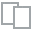
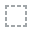
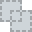
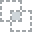
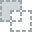
...
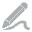
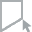
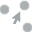
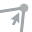
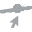

In [34]:
create_report(data).show()

## Insight

- Disini peneliti mengasumsikan ini adalah data platform streaming MNC, ada 2 tipe user,` user yang telah register dan user yang tidak register, dimana artinnya user register telah melakukan signup, sebaliknya user yang tidak register, hanya mengunjungi web dan menonton`, sebenarnya memang bisnis prosses dari MNC sendiri adalah penyiaran yang bisa di tonton gratis, dan pendapatan dapat dari iklan, dari platform ini peneliti melihat di data, `kategori yang paling diminati adalah olahraga, mungkin banyak penonton yang tidak bisa didepan tv karena aktifitas, dan akhirnya menonton lewat mobile phone, yang akhirnya banyaknya penonton di kategori olahraga`.

- Peneliti melihat ada potensi data di platform MNC, `jika banyak user yang register maka MNC bisa mendapatkan informasi dari umur , gender , dan viewer region, dimana menurut peneliti, itu adalah feature yang penting untuk pembuatan content berikutnnya`, dan terlihat didata hanya 0,45% user yang telah register, dan personal judgment peneliti sangat kurang 0.45% dan terjadinnya tidak adannya validitas data jika kita hanya mempunyai data 0.45% bahkan tidak sampai 1 %.

- Dengan hasil EDA dan analisa data sebagai data science ,` agar user ingin register adalah memberi value benefit jika menjadi user register`,peneliti akan mencoba membuat model dimana model itu, bisa menarik user untuk register.


# 3. Data Preprocessing
Bagian ini berisi proses penyiapan data untuk proses pelatihan model, seperti pembagian data menjadi train-val-test, transformasi data (normalisasi, encoding, dll.), dan proses-proses lain yang dibutuhkan

## Handling Missing Values

In [35]:
data.dropna(inplace=True)

In [36]:
data.isnull().sum()

Unnamed: 0           0
viewers_id           0
content_id           0
hit_timestamp        0
user_type            0
category_id          0
tagging              0
creator_id           0
category_name        0
viewers_birthdate    0
viewers_gender       0
viewers_region       0
dtype: int64

`hapus semua missing value, dengan anggapan untuk user register harus mengisi semua form sign up`

## 4- Make model NLP recommended system

In [37]:
#reset index
data.reset_index(drop=True, inplace=True)

In [38]:
#tampilkan data
data.head(3)

,Unnamed: 0,viewers_id,content_id,hit_timestamp,user_type,category_id,tagging,creator_id,category_name,viewers_birthdate,viewers_gender,viewers_region
0,14208,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""iLeWqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
1,14209,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""iLeWqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
2,14210,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""iLeWqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta


In [39]:
#tampilkan data tagging index 0
data["tagging"][0]

'[{"tag_id": "iLeWqd", "tag_name": "letitia-wright", "tag_slug": "letitia-wright", "status": 1, "created": {"$date": "2021-11-07T05:06:20.364Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "xhK84d", "tag_name": "black-panther-2", "tag_slug": "black-panther-2", "status": 1, "created": {"$date": "2021-09-17T11:45:28.588Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "FW4Cfm", "tag_name": "black-panther-wakanda-forever", "tag_slug": "black-panther-wakanda-forever", "status": 1, "created": {"$date": "2022-11-10T10:46:24.173Z"}, "updateat": {"$date": "0001-01-03T00:00:00.000Z"}, "backgroundimage": "", "tumbimage": "", "source": 2}]'

In [40]:
# Get stemming class from nltk library.
ps = PorterStemmer()

In [41]:
#defining the helper stemming function
def stem(text):
    y=[]
    
    for i in text.split():
        y.append(ps.stem(i))
    return " ".join(y)

In [42]:
#testing method stemming and function
ps.stem("programmers")

'programm'

In [43]:
#Iterrate over rows.
for index,row in data.iterrows():
    #print(index)
    data.loc[index, 'tagging'] = stem(row['tagging'])

In [44]:
#modeling
cv = CountVectorizer(max_features=5000,stop_words='english')
vectors = cv.fit_transform(data['tagging']).toarray()

In [45]:
#show vectors
vectors

array([[ 6,  0,  3, ...,  0,  0,  0],
       [ 6,  0,  3, ...,  0,  0,  0],
       [ 6,  0,  3, ...,  0,  0,  0],
       ...,
       [ 4,  0,  2, ...,  0,  0,  0],
       [21,  0,  8, ...,  0,  0,  0],
       [21,  0,  8, ...,  0,  0,  0]], dtype=int64)

In [46]:
#show vectors
vectors[0]

array([6, 0, 3, ..., 0, 0, 0], dtype=int64)

In [47]:
#test call model
cv.get_feature_names()

C:\Users\sumaa\anaconda3\lib\site-packages\sklearn\utils\deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


['00',
 '000',
 '0001',
 '000z',
 '0012038b54d242a283d6f3bb4226cecc',
 '001z',
 '002z',
 '003z',
 '004z',
 '005z',
 '006z',
 '007z',
 '008z',
 '009z',
 '01',
 '010z',
 '011z',
 '012z',
 '013z',
 '016z',
 '017z',
 '018z',
 '019z',
 '01n8qz',
 '01t00',
 '01t01',
 '01t02',
 '01t03',
 '01t04',
 '01t05',
 '01t06',
 '01t07',
 '01t08',
 '01t09',
 '01t10',
 '01t11',
 '01t12',
 '01t13',
 '01t14',
 '01t16',
 '02',
 '020z',
 '021z',
 '022z',
 '023z',
 '024',
 '024z',
 '025z',
 '026z',
 '027z',
 '028z',
 '029z',
 '02t01',
 '02t02',
 '02t03',
 '02t04',
 '02t05',
 '02t06',
 '02t09',
 '02t10',
 '02t11',
 '02t12',
 '02t13',
 '02t14',
 '02t15',
 '02t16',
 '02t17',
 '02t19',
 '02t20',
 '02t22',
 '02t23',
 '03',
 '030z',
 '031z',
 '032z',
 '033z',
 '034z',
 '035z',
 '036z',
 '037z',
 '038z',
 '039z',
 '03t00',
 '03t01',
 '03t02',
 '03t03',
 '03t04',
 '03t05',
 '03t06',
 '03t07',
 '03t08',
 '03t09',
 '03t11',
 '03t12',
 '03t14',
 '03t15',
 '03t18',
 '03t23',
 '04',
 '040z',
 '041z',
 '042z',
 '043z',
 '04

In [48]:
#devine method cosin similarity
similarity = cosine_similarity(vectors)

In [49]:
#tampilkan index ke 0
similarity[0]

array([1.        , 1.        , 1.        , ..., 0.78608176, 0.58121342,
       0.58121342])

In [50]:
#tampilkan shape
similarity.shape

(3295, 3295)

In [51]:
#cek tampilkan
data[data['tagging'].str.contains("black-panther-wakanda-forever")]

,Unnamed: 0,viewers_id,content_id,hit_timestamp,user_type,category_id,tagging,creator_id,category_name,viewers_birthdate,viewers_gender,viewers_region
0,14208,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""ilewqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
1,14209,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""ilewqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
2,14210,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""ilewqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
3,14211,HD8ZXY,7YxHCJ,2022-11-13,Register User,23.0,"[{""tag_id"": ""ilewqd"", ""tag_name"": ""letitia-wri...",61a488153d721e2466a44341,Hiburan,2000-10-07,Female,Jakarta
33,22774,HD8ZXY,fe24e77a126d4e80ba06a853cc042a61,2022-11-13,Register User,23.0,"[{""tag_id"": ""qqlmmj"", ""tag_name"": ""film-baru"",...",39jY82,Hiburan,2000-10-07,Female,Jakarta
34,22775,HD8ZXY,fe24e77a126d4e80ba06a853cc042a61,2022-11-13,Register User,23.0,"[{""tag_id"": ""qqlmmj"", ""tag_name"": ""film-baru"",...",39jY82,Hiburan,2000-10-07,Female,Jakarta
35,22776,HD8ZXY,fe24e77a126d4e80ba06a853cc042a61,2022-11-13,Register User,23.0,"[{""tag_id"": ""qqlmmj"", ""tag_name"": ""film-baru"",...",39jY82,Hiburan,2000-10-07,Female,Jakarta
36,23889,HD8ZXY,83f79691e4d14ff9956e3d2a15dd6966,2022-11-13,Register User,23.0,"[{""tag_id"": ""fw4cfm"", ""tag_name"": ""black-panth...",39jY82,Hiburan,2000-10-07,Female,Jakarta
37,23890,HD8ZXY,83f79691e4d14ff9956e3d2a15dd6966,2022-11-13,Register User,23.0,"[{""tag_id"": ""fw4cfm"", ""tag_name"": ""black-panth...",39jY82,Hiburan,2000-10-07,Female,Jakarta
38,23891,HD8ZXY,83f79691e4d14ff9956e3d2a15dd6966,2022-11-13,Register User,23.0,"[{""tag_id"": ""fw4cfm"", ""tag_name"": ""black-panth...",39jY82,Hiburan,2000-10-07,Female,Jakarta


In [52]:
#tampilkan similarity sort
sorted(similarity[100])

[0.36320278645706605,
 0.36320278645706605,
 0.36320278645706605,
 0.36320278645706605,
 0.39710963034507185,
 0.39710963034507185,
 0.45683219257612856,
 0.45683219257612856,
 0.45683219257612856,
 0.45683219257612856,
 0.45683219257612856,
 0.4633124055032066,
 0.4633124055032066,
 0.47422310806400925,
 0.47422310806400925,
 0.4771456634925265,
 0.4771456634925265,
 0.4963157204534316,
 0.4963157204534316,
 0.4963157204534316,
 0.5004345937369794,
 0.5004345937369794,
 0.5006174677038864,
 0.5006174677038864,
 0.5006174677038864,
 0.5006174677038864,
 0.5006174677038864,
 0.5023237925348387,
 0.5023237925348387,
 0.5080779725277167,
 0.5390463612440546,
 0.5390463612440546,
 0.539493755020098,
 0.539493755020098,
 0.5429167967842031,
 0.5429167967842031,
 0.5429167967842031,
 0.5429167967842031,
 0.5550957868366563,
 0.5550957868366563,
 0.5565966780118031,
 0.5565966780118031,
 0.5565966780118031,
 0.5565966780118031,
 0.5570881542029359,
 0.5570881542029359,
 0.5570881542029359,
 0

In [53]:
#tes show
for count, value in enumerate(similarity[100]):
    print(count, value)

0 0.7902912368010206
1 0.7902912368010206
2 0.7902912368010206
3 0.7902912368010206
4 0.881134221062802
5 0.881134221062802
6 0.881134221062802
7 0.8636989916609341
8 0.8636989916609341
9 0.8636989916609341
10 0.8636989916609341
11 0.8636989916609341
12 0.8636989916609341
13 0.8636989916609341
14 0.8636989916609341
15 0.8636989916609341
16 0.8636989916609341
17 0.8636989916609341
18 0.8636989916609341
19 0.8636989916609341
20 0.8636989916609341
21 0.8636989916609341
22 0.8636989916609341
23 0.8636989916609341
24 0.8636989916609341
25 0.8457397915070284
26 0.8457397915070284
27 0.8457397915070284
28 0.8457397915070284
29 0.8457397915070284
30 0.8147959395531857
31 0.8147959395531857
32 0.8147959395531857
33 0.8389854805581362
34 0.8389854805581362
35 0.8389854805581362
36 0.7990946738650808
37 0.7990946738650808
38 0.7990946738650808
39 0.641138282446112
40 0.641138282446112
41 0.8177371544135925
42 0.8177371544135925
43 0.8453899498753737
44 0.8971292429353797
45 0.8971292429353797
46 

588 0.8866484166159742
589 0.5006174677038864
590 0.5006174677038864
591 0.5006174677038864
592 0.877850123588398
593 0.877850123588398
594 0.877850123588398
595 0.877850123588398
596 0.8105805836212727
597 0.8105805836212727
598 0.8105805836212727
599 0.8105805836212727
600 0.8105805836212727
601 0.6560418166347889
602 0.6560418166347889
603 0.6560418166347889
604 0.6560418166347889
605 0.6560418166347889
606 0.6560418166347889
607 0.8505415086315543
608 0.8505415086315543
609 0.8645260722460992
610 0.8645260722460992
611 0.8911956912597478
612 0.8911956912597478
613 0.7272413705699445
614 0.7272413705699445
615 0.8555762220464153
616 0.8555762220464153
617 0.8596264449059775
618 0.8596264449059775
619 0.8581856729523114
620 0.8581856729523114
621 0.8460734536815003
622 0.8460734536815003
623 0.8547395569089612
624 0.8547395569089612
625 0.8397977154222125
626 0.8397977154222125
627 0.8950599121717002
628 0.8950599121717002
629 0.8509263660060762
630 0.8509263660060762
631 0.905185339

1088 0.8118860419526901
1089 0.8453899498753737
1090 0.8534799901845883
1091 0.9127692253739478
1092 0.8587811591063714
1093 0.9051189184503623
1094 0.8987441075102797
1095 0.8494886025144257
1096 0.9018374173429216
1097 0.8939525448358521
1098 0.8982792650896746
1099 0.8883301383959732
1100 0.837525686389569
1101 0.837525686389569
1102 0.837525686389569
1103 0.837525686389569
1104 0.837525686389569
1105 0.837525686389569
1106 0.837525686389569
1107 0.837525686389569
1108 0.837525686389569
1109 0.837525686389569
1110 0.837525686389569
1111 0.837525686389569
1112 0.837525686389569
1113 0.837525686389569
1114 0.837525686389569
1115 0.837525686389569
1116 0.837525686389569
1117 0.837525686389569
1118 0.837525686389569
1119 0.837525686389569
1120 0.837525686389569
1121 0.837525686389569
1122 0.837525686389569
1123 0.8466445278401906
1124 0.8466445278401906
1125 0.8478674860821445
1126 0.8478674860821445
1127 0.8478674860821445
1128 0.8160470919969213
1129 0.8970025875894931
1130 0.89700258

1616 0.8796788506680449
1617 0.8796788506680449
1618 0.8490336113288215
1619 0.8490336113288215
1620 0.8490336113288215
1621 0.733047114826925
1622 0.733047114826925
1623 0.84770956790334
1624 0.84770956790334
1625 0.84770956790334
1626 0.8725663744267285
1627 0.81773471621416
1628 0.81773471621416
1629 0.63093337451503
1630 0.8490106059997725
1631 0.8490106059997725
1632 0.8490106059997725
1633 0.8667034510850653
1634 0.8667034510850653
1635 0.8487168641578674
1636 0.8487168641578674
1637 0.7521742078696346
1638 0.7521742078696346
1639 0.8989942954980351
1640 0.8989942954980351
1641 0.539493755020098
1642 0.539493755020098
1643 0.8400289340976113
1644 0.8400289340976113
1645 0.8455461891398677
1646 0.8455461891398677
1647 0.881118896856137
1648 0.862230931552142
1649 0.862230931552142
1650 0.862230931552142
1651 0.862230931552142
1652 0.8177201082197276
1653 0.8177201082197276
1654 0.8146854451761979
1655 0.5966951207839837
1656 0.5966951207839837
1657 0.8750325151892494
1658 0.875032

2114 0.8261765419236607
2115 0.8261765419236607
2116 0.8261765419236607
2117 0.8261765419236607
2118 0.8261765419236607
2119 0.8261765419236607
2120 0.8668807377250547
2121 0.8509296698327952
2122 0.8509296698327952
2123 0.8273592536878666
2124 0.8233697727637359
2125 0.8233697727637359
2126 0.8273592536878666
2127 0.8344408667498863
2128 0.8261765419236607
2129 0.8261765419236607
2130 0.8509296698327952
2131 0.8509296698327952
2132 0.8273592536878666
2133 0.8273592536878666
2134 0.8273592536878666
2135 0.8273592536878666
2136 0.9072494696838054
2137 0.9072494696838054
2138 0.7820485697351809
2139 0.7820485697351809
2140 0.7820485697351809
2141 0.7820485697351809
2142 0.8701005199579989
2143 0.8701005199579989
2144 0.8701005199579989
2145 0.8158724588651952
2146 0.8382279445094407
2147 0.8598187868043472
2148 0.8973142752654764
2149 0.8758268914696137
2150 0.8350156691970083
2151 0.8791848453262825
2152 0.8832103054832374
2153 0.8832103054832374
2154 0.8832103054832374
2155 0.883210305

2588 0.8146854451761979
2589 0.8146854451761979
2590 0.8794471134975652
2591 0.8794471134975652
2592 0.8794471134975652
2593 0.8794471134975652
2594 0.8794471134975652
2595 0.8794471134975652
2596 0.8794471134975652
2597 0.8794471134975652
2598 0.8794471134975652
2599 0.8794471134975652
2600 0.8794471134975652
2601 0.7833226675064511
2602 0.7833226675064511
2603 0.7833226675064511
2604 0.7786279483393137
2605 0.7786279483393137
2606 0.7786279483393137
2607 0.7786279483393137
2608 0.7786279483393137
2609 0.8640683319850123
2610 0.8640683319850123
2611 0.8640683319850123
2612 0.8640683319850123
2613 0.8640683319850123
2614 0.8640683319850123
2615 0.8507878878706724
2616 0.868140817068792
2617 0.8327893104580312
2618 0.8923974283909724
2619 0.7189559546347506
2620 0.7189559546347506
2621 0.7189559546347506
2622 0.7189559546347506
2623 0.7189559546347506
2624 0.8577865351569536
2625 0.8577865351569536
2626 0.8577865351569536
2627 0.8361638359043688
2628 0.8361638359043688
2629 0.8361638359

3087 0.764230448630121
3088 0.764230448630121
3089 0.764230448630121
3090 0.764230448630121
3091 0.764230448630121
3092 0.9040718424121389
3093 0.9040718424121389
3094 0.8326062565419179
3095 0.8326062565419179
3096 0.8062029235969146
3097 0.8062029235969146
3098 0.8062029235969146
3099 0.8786477769113926
3100 0.8786477769113926
3101 0.8417878513556284
3102 0.8417878513556284
3103 0.8389854805581362
3104 0.8389854805581362
3105 0.8389854805581362
3106 0.8389854805581362
3107 0.8389854805581362
3108 0.8389854805581362
3109 0.8389854805581362
3110 0.8389854805581362
3111 0.8389854805581362
3112 0.8389854805581362
3113 0.8389854805581362
3114 0.8389854805581362
3115 0.8389854805581362
3116 0.8389854805581362
3117 0.8389854805581362
3118 0.8389854805581362
3119 0.8389854805581362
3120 0.8389854805581362
3121 0.8389854805581362
3122 0.8389854805581362
3123 0.8862282198541773
3124 0.8448589801827235
3125 0.8448589801827235
3126 0.8448589801827235
3127 0.8448589801827235
3128 0.84485898018272

In [54]:
#tes show
list(enumerate(similarity[100]))

[(0, 0.7902912368010206),
 (1, 0.7902912368010206),
 (2, 0.7902912368010206),
 (3, 0.7902912368010206),
 (4, 0.881134221062802),
 (5, 0.881134221062802),
 (6, 0.881134221062802),
 (7, 0.8636989916609341),
 (8, 0.8636989916609341),
 (9, 0.8636989916609341),
 (10, 0.8636989916609341),
 (11, 0.8636989916609341),
 (12, 0.8636989916609341),
 (13, 0.8636989916609341),
 (14, 0.8636989916609341),
 (15, 0.8636989916609341),
 (16, 0.8636989916609341),
 (17, 0.8636989916609341),
 (18, 0.8636989916609341),
 (19, 0.8636989916609341),
 (20, 0.8636989916609341),
 (21, 0.8636989916609341),
 (22, 0.8636989916609341),
 (23, 0.8636989916609341),
 (24, 0.8636989916609341),
 (25, 0.8457397915070284),
 (26, 0.8457397915070284),
 (27, 0.8457397915070284),
 (28, 0.8457397915070284),
 (29, 0.8457397915070284),
 (30, 0.8147959395531857),
 (31, 0.8147959395531857),
 (32, 0.8147959395531857),
 (33, 0.8389854805581362),
 (34, 0.8389854805581362),
 (35, 0.8389854805581362),
 (36, 0.7990946738650808),
 (37, 0.799094

In [55]:
#tes show
sorted(list(enumerate(similarity[100])),reverse=True)

[(3294, 0.6581272467554188),
 (3293, 0.6581272467554188),
 (3292, 0.8261765419236607),
 (3291, 0.8261765419236607),
 (3290, 0.8957730076826703),
 (3289, 0.8957730076826703),
 (3288, 0.9043106644167024),
 (3287, 0.9043106644167024),
 (3286, 0.8649172454242227),
 (3285, 0.8261765419236607),
 (3284, 0.8261765419236607),
 (3283, 0.8261765419236607),
 (3282, 0.8261765419236607),
 (3281, 0.8600829369913598),
 (3280, 0.8600829369913598),
 (3279, 0.8585492091215268),
 (3278, 0.873313343622151),
 (3277, 0.9020935853383959),
 (3276, 0.8707943981644107),
 (3275, 0.8776289410334728),
 (3274, 0.8776289410334728),
 (3273, 0.8776289410334728),
 (3272, 0.8776289410334728),
 (3271, 0.8776289410334728),
 (3270, 0.8846629067040301),
 (3269, 0.9111769533802516),
 (3268, 0.6828285350310941),
 (3267, 0.6828285350310941),
 (3266, 0.8150522484790592),
 (3265, 0.8150522484790592),
 (3264, 0.6664970490360238),
 (3263, 0.6664970490360238),
 (3262, 0.8793571066950037),
 (3261, 0.8826591376380528),
 (3260, 0.76257

In [56]:
#tes show
sorted(list(enumerate(similarity[100])),reverse=True, key=lambda x:x[1])

[(99, 0.9999999999999998),
 (100, 0.9999999999999998),
 (101, 0.9999999999999998),
 (102, 0.9999999999999998),
 (2727, 0.917263040722515),
 (79, 0.9172142259861717),
 (80, 0.9172142259861717),
 (81, 0.9172142259861717),
 (82, 0.9172142259861717),
 (1542, 0.913664385152257),
 (670, 0.9135901586143629),
 (1183, 0.912914035221281),
 (1091, 0.9127692253739478),
 (95, 0.9123158022988962),
 (96, 0.9123158022988962),
 (97, 0.9123158022988962),
 (98, 0.9123158022988962),
 (120, 0.9123158022988962),
 (121, 0.9123158022988962),
 (122, 0.9123158022988962),
 (123, 0.9123158022988962),
 (139, 0.9123158022988962),
 (140, 0.9123158022988962),
 (2366, 0.9113309615616566),
 (3269, 0.9111769533802516),
 (306, 0.9109795001669543),
 (1530, 0.9107378498743423),
 (1531, 0.9107378498743423),
 (2853, 0.9102573805081082),
 (417, 0.9100630858438685),
 (70, 0.9096008778951647),
 (71, 0.9096008778951647),
 (72, 0.9096008778951647),
 (73, 0.9096008778951647),
 (2034, 0.9091881926516017),
 (2035, 0.9091881926516017

In [57]:
def recommend(movie):
    #movie_index = new_df[new_df['title'] == movie].index[0]
    movie_list = data[data['tagging'].str.contains(movie)]
    if len(movie_list):  
        movie_idx= movie_list.index[0]
        distances = similarity[movie_idx]
        movies_list = sorted(list(enumerate(distances)),reverse=True, key=lambda x:x[1])[1:6]
    
        #
        print('Recommendations for {0} :\n'.format(movie_list.iloc[0]['tagging']))
        for i in movies_list:
            print(data.iloc[i[0]].tagging)
    else:
        return "No movies found. Please check your input"

In [61]:
recommend('hiburan')

Recommendations for [{"tag_id": "veac5e", "tag_name": "anime", "tag_slug": "anime", "status": 1, "created": {"$date": "2022-07-09t07:04:04.552z"}, "updateat": {"$date": "0001-01-03t00:00:00.000z"}, "backgroundimage": "", "tumbimage": "", "source": 2}, {"tag_id": "x6e8eb", "tag_name": "onepiece", "tag_slug": "onepiece", "status": 1, "created": {"$date": "2021-12-23t05:41:36.390z"}, "updateat": {"$date": "0001-01-03t00:00:00.000z"}, "backgroundimage": "", "tumbimage": "", "source": 1}, {"tag_id": "ha7emy", "tag_name": "keren", "tag_slug": "keren", "status": 1, "created": {"$date": "2022-02-14t07:07:08.770z"}, "updateat": {"$date": "0001-01-03t00:00:00.000z"}, "backgroundimage": "", "tumbimage": "", "source": 1}, {"tag_id": "askyfy", "tag_name": "hiburan", "tag_slug": "hiburan", "status": 1, "created": {"$date": "2021-09-14t04:12:23.774z"}, "updateat": {"$date": "0001-01-03t00:00:00.000z"}, "backgroundimage": "https://img.celebrities.id/okz/800/fp32t4/master_88p4r99wkg_1346_indra_frimawan

# 5. Conclusion / Overall Analysis

### EDA :
`Di dataset ini ada 12 columns, 958547 row, dan memilik 2 column bertipe numerik int dan float`
`Terlihat disini untuk column Unnamed sebanyak jumlah index banyaknnya ROW yang artinnya Column Unnamed sama seperti penomoran jumlah row`, untuk column `category_id , angka paling kecilnnya di angka 13 dan max 36, dan nilai median ada di angka 30, yang artinnya dimana paling banyak di category_id 30`, tapi peneliti akan mencari lebih jauh lagi untuk mengerti di EDA ini.
`jumlah index dan jumlah colum Unnamed terlihat sama, peneliti menyimpulkan column ini hanya sebagai penomoran saja`
`Jumlah Viewers ada di `54632 dari 958547 banyaknnya row`
`dari data disini peneliti menyimpulkan hanya 54632 penonton dimana 5.6% dari dataset yang dipunya MNC`
`Terdapat 24097 content, `disini peneliti menyimpulkan dari data ini, bahwa MNC mempunyai 24097 content `
untuk `column hit_timestamp adalah penandaan tanggal dan seberapa sering di tanggal itu user dan conten tercaptured`
Anonymous User dan register user, `personal judgment peneliti adalah, karena MNC adalah perusahaan yang bisnis prossesnnya adalah siaran gratis dan mendapatkan pendapatan salah satunnya dari iklan, artinnya user tidak perlu register untuk menonton content yang diberikan mnc, maka dari itu adannya Anonymus User`
`Terlihat dari data dan visual peringka 1 ada di categori conten olahraga`
`dari creator membuat conten dengan rata2 2.3% dari banyaknya conten yang ada sekarang`
`untuk viewers_birthdate, viewers_gender, viewers_region , user yang tidak register , MNC tidak bisa captured datannya, karena mereka bisa nonton walaupun tidak register`

### Preproces:
- Peneliti memustuskan untuk hapus semua missing value untuk pembuatan modeling

### Model:
- Peneliti memakai CountVectorizer ()
- Peneliti memakai teknik cosine_similarity
- Model berhasil membaca text classification


### Kesimpulan:
- Disini peneliti mengasumsikan ini adalah data platform streaming MNC, ada 2 tipe user,` user yang telah register dan user yang tidak register, dimana artinnya user register telah melakukan signup, sebaliknya user yang tidak register, hanya mengunjungi web dan menonton`, sebenarnya memang bisnis prosses dari MNC sendiri adalah penyiaran yang bisa di tonton gratis, dan pendapatan dapat dari iklan, dari platform ini peneliti melihat di data, `kategori yang paling diminati adalah olahraga, mungkin banyak penonton yang tidak bisa didepan tv karena aktifitas, dan akhirnya menonton lewat mobile phone, yang akhirnya banyaknya penonton di kategori olahraga`.

- Peneliti melihat ada potensi data di platform MNC, `jika banyak user yang register maka MNC bisa mendapatkan informasi dari umur , gender , dan viewer region, dimana menurut peneliti, itu adalah feature yang penting untuk pembuatan dan penyajian content berikutnnya`, dan terlihat didata hanya 0,45% user yang telah register, dan personal judgment peneliti sangat kurang 0.45% dan terjadinnya tidak adannya validitas data jika kita hanya mempunyai data 0.45% bahkan tidak sampai 1 %.

- Dengan hasil EDA dan analisa data sebagai data science ,` agar user ingin register, salah satunnya adalah memberi value benefit jika menjadi user register`,peneliti akan mencoba membuat model dimana model itu diharapkan bisa menjadi feature tambahan agar bisa menarik user untuk register.

- dari pembuatan model dan preproces peneliti tidak bisa maksimal dikarenakan kurangnnya resource dan waktu.




In [59]:
#save CSV
data.to_csv('mnc.csv')